In [1]:
%pylab inline

In /home/sazadi/anaconda3-2/lib/python3.6/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The text.latex.unicode rcparam was deprecated in Matplotlib 3.0 and will be removed in 3.2.
In /home/sazadi/anaconda3-2/lib/python3.6/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The savefig.frameon rcparam was deprecated in Matplotlib 3.1 and will be removed in 3.3.
In /home/sazadi/anaconda3-2/lib/python3.6/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The pgf.debug rcparam was deprecated in Matplotlib 3.0 and will be removed in 3.2.
In /home/sazadi/anaconda3-2/lib/python3.6/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The verbose.level rcparam was deprecated in Matplotlib 3.1 and will be removed in 3.3.
In /home/sazadi/anaconda3-2/lib/python3.6/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The verbose.fileo rcparam was deprecated in Matplotlib 3.1 and will be removed in 3.3.


Populating the interactive namespace from numpy and matplotlib


In [7]:
import sys
sys.path.insert(0,'/home/sazadi/projects/Obj-GAN/shape_generation/')

import pycocotools
import pickle
import glob

In [4]:
from pycocotools.coco import COCO
import numpy as np
import skimage.io as io
import matplotlib.pyplot as plt
import pylab
pylab.rcParams['figure.figsize'] = (8.0, 10.0)

In [5]:
dataDir='../data/coco'
dataType='train2014'
annFile='{}/insanns/instances_{}.json'.format(dataDir,dataType)


In [10]:
# initialize COCO api for instance annotations
coco=COCO(annFile)


loading annotations into memory...
Done (t=7.91s)
creating index...
index created!


In [2]:
# display COCO categories and supercategories
cats = coco.loadCats(coco.getCatIds())
nms=[cat['name'] for cat in cats]
print('COCO categories: \n{}\n'.format(' '.join(nms)))

nms = set([cat['supercategory'] for cat in cats])
print('COCO supercategories: \n{}'.format(' '.join(nms)))


NameError: name 'coco' is not defined

In [14]:
# get all images containing given categories, select one at random
catIds = coco.getCatIds(catNms=['dog']);
imgIds = coco.getImgIds(catIds=catIds );
# print(imgIds)
imgIds = coco.getImgIds(imgIds = [311301])
img = coco.loadImgs(imgIds[np.random.randint(0,len(imgIds))])[0]


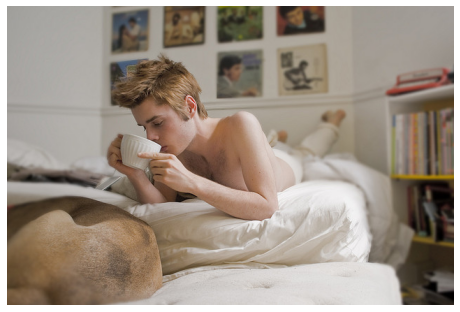

In [16]:
I = io.imread(img['coco_url'])
plt.axis('off')
plt.imshow(I)


In [5]:
filepath = '../data/coco/test_acts_tf1.pickle'
with open(filepath, 'rb') as f:
    x = pickle.load(f)
    acts_dict = x[0]
    print(acts_dict.keys())
    aaa


dict_keys(['COCO_val2014_000000412978', 'COCO_val2014_000000412975', 'COCO_val2014_000000243260', 'COCO_val2014_000000452201', 'COCO_val2014_000000391588', 'COCO_val2014_000000391584', 'COCO_val2014_000000147375', 'COCO_val2014_000000380609', 'COCO_val2014_000000318373', 'COCO_val2014_000000007276', 'COCO_val2014_000000384114', 'COCO_val2014_000000007274', 'COCO_val2014_000000456917', 'COCO_val2014_000000130419', 'COCO_val2014_000000007278', 'COCO_val2014_000000216710', 'COCO_val2014_000000088412', 'COCO_val2014_000000488720', 'COCO_val2014_000000309940', 'COCO_val2014_000000488723', 'COCO_val2014_000000424551', 'COCO_val2014_000000424554', 'COCO_val2014_000000307243', 'COCO_val2014_000000136768', 'COCO_val2014_000000132223', 'COCO_val2014_000000016451', 'COCO_val2014_000000506356', 'COCO_val2014_000000506357', 'COCO_val2014_000000274331', 'COCO_val2014_000000268000', 'COCO_val2014_000000542077', 'COCO_val2014_000000280083', 'COCO_val2014_000000542073', 'COCO_val2014_000000085764', 'CO

NameError: name 'aaa' is not defined

In [6]:
def read_imgs(data_dir, filenames, filepath):
    img_bytes = []
    print('start loading bigfile (%0.02f GB) into memory' % (os.path.getsize(filepath)/1024/1024/1024))
    with open(filepath, 'rb') as fid:
        for img_index in range(len(filenames)):
            img_bytes_len = struct.unpack('i', fid.read(4))[0]
            img_bytes.append(fid.read(img_bytes_len))

    return img_bytes


In [ ]:
filepath = '../data/coco/test_imgs.bigfile'
img_bytes = read_imgs(data_dir, filenames, filepath)


In [19]:
f_dir = '/home/sazadi/projects/Obj-GAN/data/coco/box_label'
fnms = '%s/filenames_val2014.txt'%f_dir
inp = '%s/input_val2014.txt'%f_dir
with open(fnms,'r') as f:
    f_names = f.readlines()
with open(inp,'r') as I:
    f_box = I.readlines()

print(f_box[0])
captions = [box.split('\t')[0] for box in f_box ]
print(captions[0])

two giraffe standing next to each other in a forest	187.47 59.73	148.00 170.40	96.53 84.27	0.70 0.80	25 25

two giraffe standing next to each other in a forest


In [20]:
len(f_names)

200825

In [21]:
len(f_box)

200825

In [5]:
import glob
import shutil
train_caps= glob.glob('../data/coco/train2014/*.txt')
for f in train_caps:
    f_name = f.split('/')[-1]
    shutil.copy2(f, '../data/coco/text')

In [6]:
train_caps= glob.glob('../data/coco/val2014/*.txt')
for f in train_caps:
    f_name = f.split('/')[-1]
    shutil.copy2(f, '../data/coco/text')

In [26]:
caps_loc = '/home/sazadi/projects/Obj-GAN/data/coco/text'
ims = glob.glob('/home/sazadi/projects/Obj-GAN/output_image_generation/coco_2020_07_02_00_17_03/Image/*.jpg')
im_names= [im.split('/')[-1].split('.jpg')[0] for im in ims]
num_embeddings = 5
sents = []
for im in im_names:
    sent_id = int(im.rsplit('_',1)[1]) % num_embeddings
    cap = '%s/%s.txt'%(caps_loc, im.rsplit('_',1)[0])
    with open(cap,'r') as f:
        f_names = f.readlines()
        sents.append(f_names[sent_id])
        print(f_names[sent_id])


Two giraffes in a field feeding on trees. 

A teddy bear taped to the wall with a sign that says won't kill you.



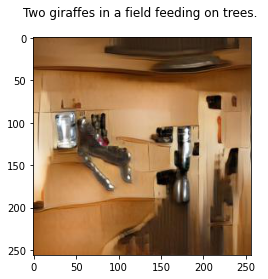

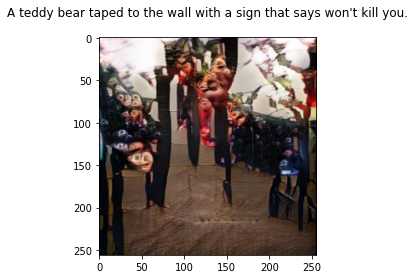

In [27]:
for i,im in enumerate(ims):
    figure()
    imshow(imread(im))
    title(sents[i])

In [34]:
all_dirs = glob.glob('/home/sazadi/projects/Obj-GAN/output_image_generation/*')
for dr in all_dirs:
    print(len(glob.glob('%s/Image/*'%dr)))
    if len(glob.glob('%s/Image/*'%dr))>80:
        print(dr)

24
6
0
24
24
0
24
0
12
6
0
0
0
24
0
24
0
0
24
0
2
24
0
0
24
24
24
24
0
0
0
6
24
0
24
0
2
0
84
/home/sazadi/projects/Obj-GAN/output_image_generation/coco_2020_06_26_21_02_22
24
84
/home/sazadi/projects/Obj-GAN/output_image_generation/coco_2020_06_27_00_03_31
2
24
24
0
0
0
24
0
24
0
0
24
0
0
24
24
2
0
0
24
24
0
24
24
0
0
0
24
24
84
/home/sazadi/projects/Obj-GAN/output_image_generation/coco_2020_06_29_19_17_01
24
6
24
24
0


/home/sazadi/anaconda3-2/lib/python3.6/site-packages/ipykernel_launcher.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  from ipykernel import kernelapp as app


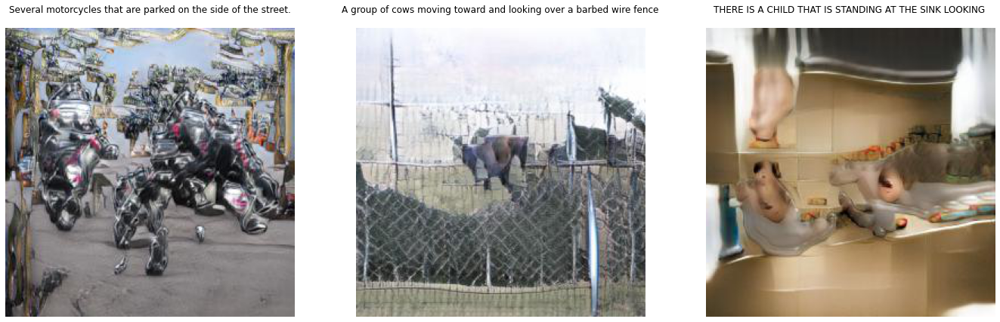

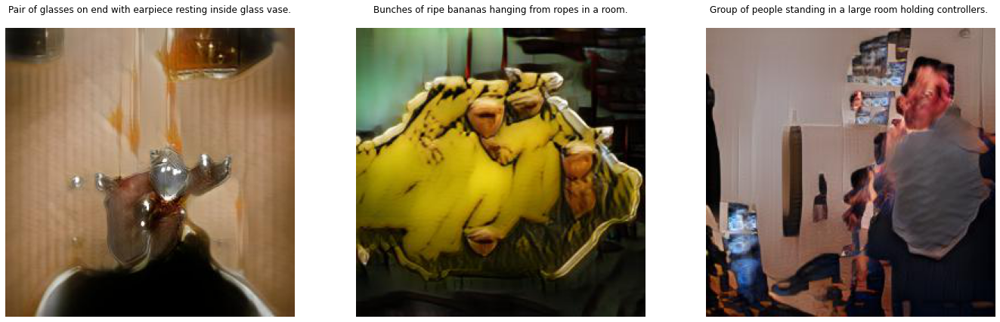

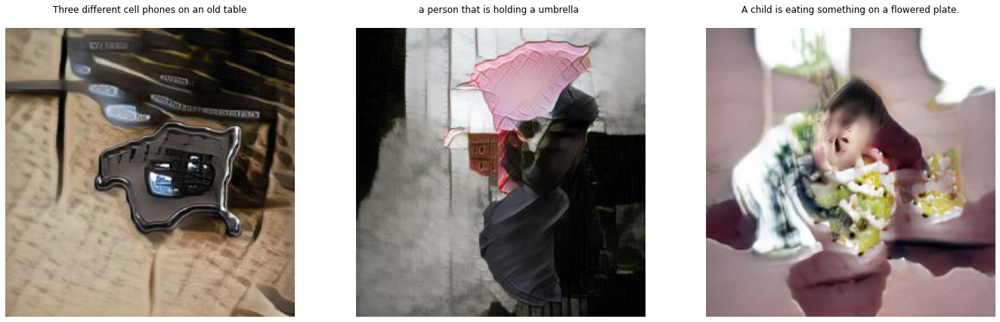

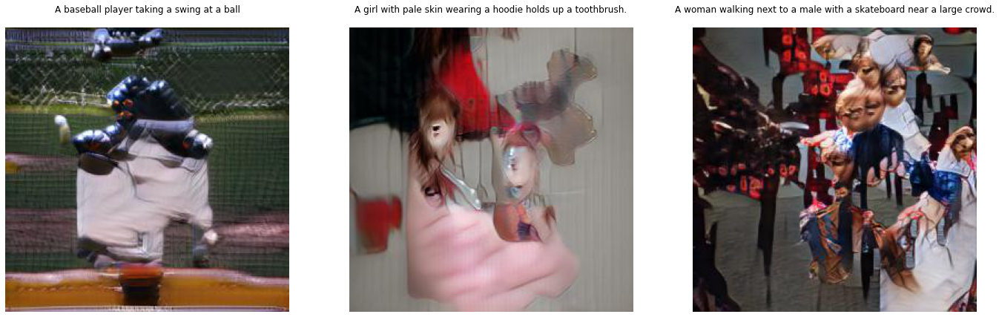

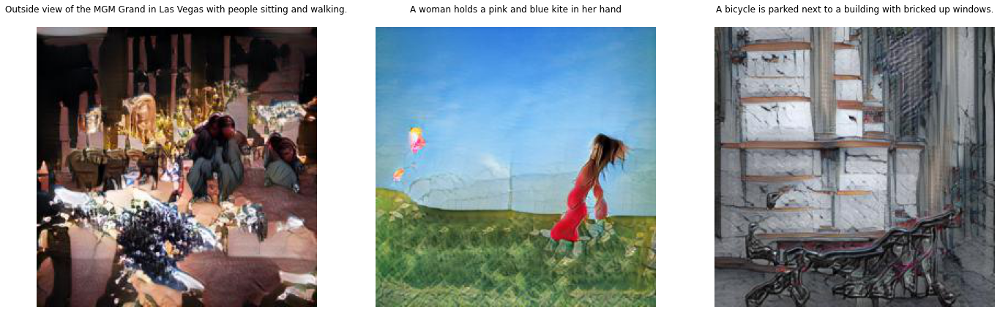

...

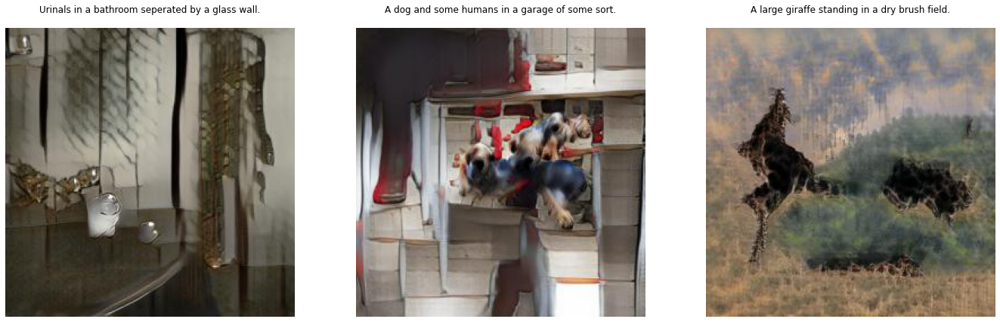

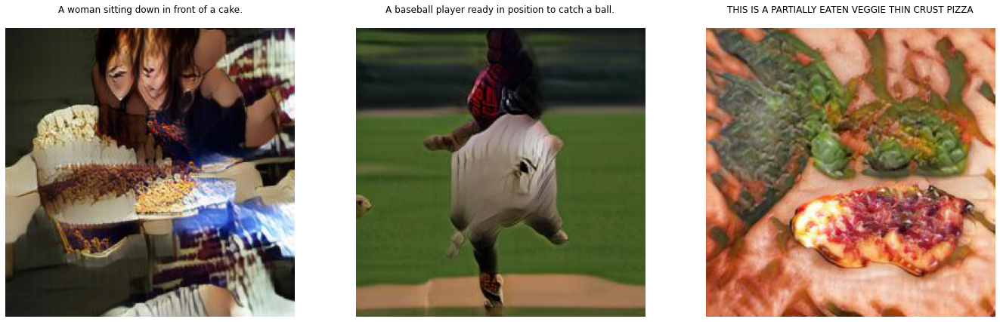

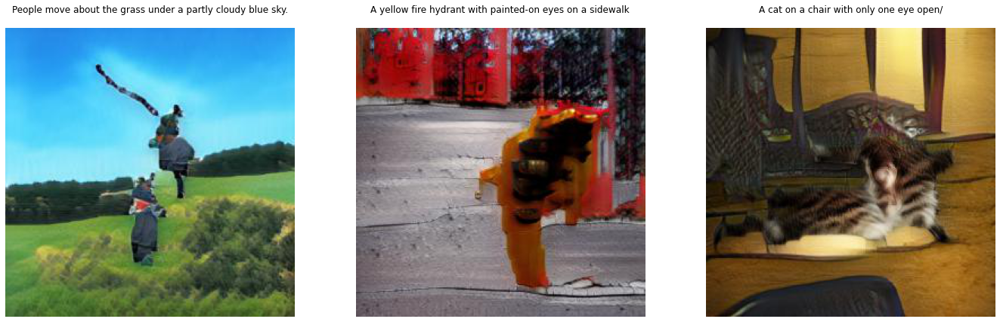

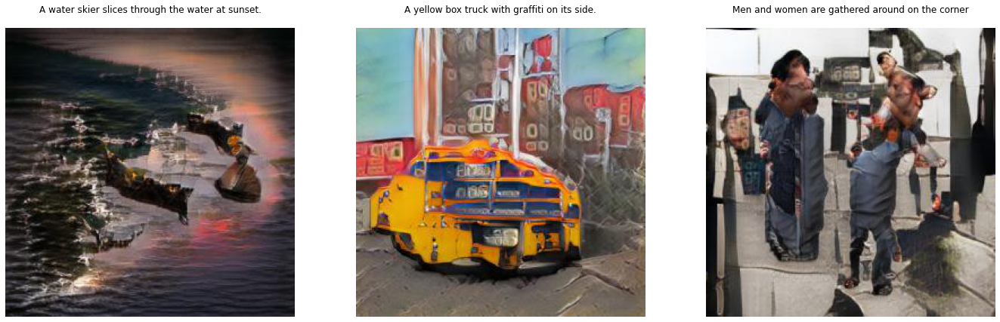

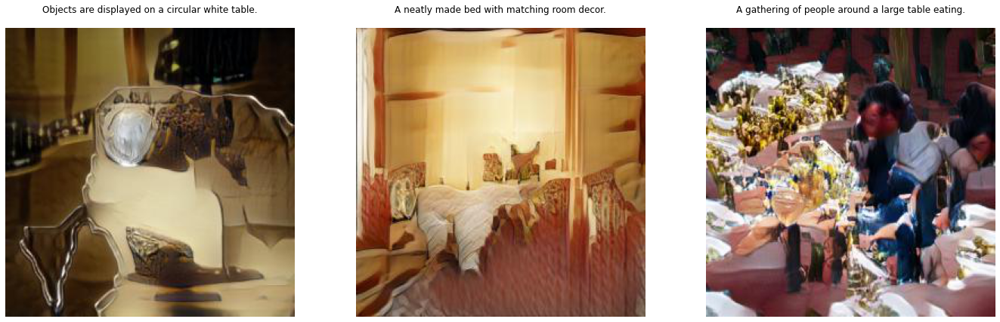

In [8]:
caps_loc = '/home/sazadi/projects/Obj-GAN/data/coco/text'
ims = glob.glob('/home/sazadi/projects/Obj-GAN/output_image_generation/coco_2020_07_03_00_57_36/Image/*.jpg')
im_names= [im.split('/')[-1].split('.jpg')[0] for im in ims]
num_embeddings = 5
sents = []
for im in im_names:
    sent_id = int(im.rsplit('_',1)[1]) % num_embeddings
    cap = '%s/%s.txt'%(caps_loc, im.rsplit('_',1)[0])
    with open(cap,'r') as f:
        f_names = f.readlines()
        sents.append(f_names[sent_id])

for i,im in enumerate(ims):
    if i%3==0:
        fig, axs = plt.subplots(1, 3, figsize=(20, 20))
        fig.tight_layout(pad=5.0)
    j = i%3
    axs[j].imshow(imread(im))
    axs[j].set_title(sents[i])#'%s\n %s'%(sents[i][0:35],sents[i][35:-1]))
    axs[j].set_axis_off()


In [39]:
filepath = '../data/coco/captions.pickle'
with open(filepath, 'rb') as f:
    c = pickle.load(f)
len(c)

4

In [51]:
c[1][0]

[23046, 1899, 14938, 822, 23046, 24769, 26771, 26444, 20608]

In [50]:
[c[2][iii] for iii in c[1][0]]

['a', 'kitchen', 'counter', 'with', 'a', 'rounded', 'edge', 'and', 'shelves']

In [74]:
c = ['COCO_val2014_000000145009','COCO_val2014_000000338200','COCO_black_dog_banana',
     'COCO_val2014_000000054679','COCO_val2014_000000297233','COCO_val2014_000000086843','COCO_yellow_dog_banana',
    'COCO_red_horse','COCO_val2014_000000165643','COCO_val2014_000000573928','COCO_blue_cow','COCO_plane_tree',
    'COCO_polka_dog']
with open('../data/coco/test_short/filenames.pickle', 'wb') as fp:
    pickle.dump(c, fp)


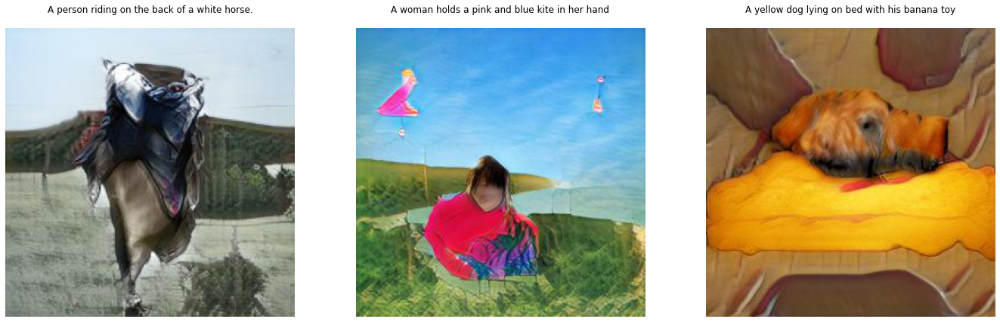

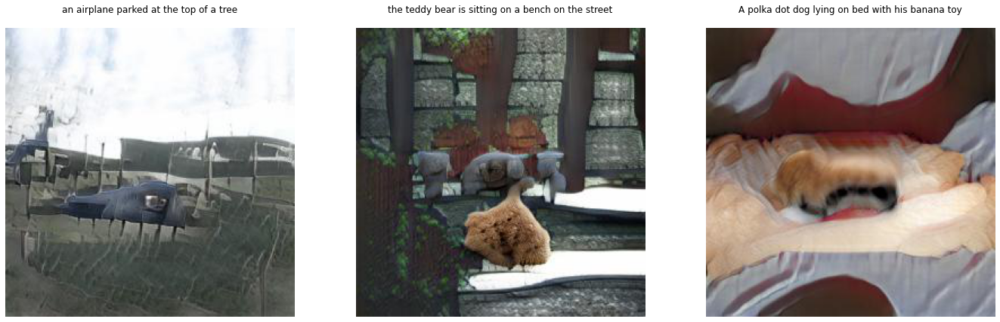

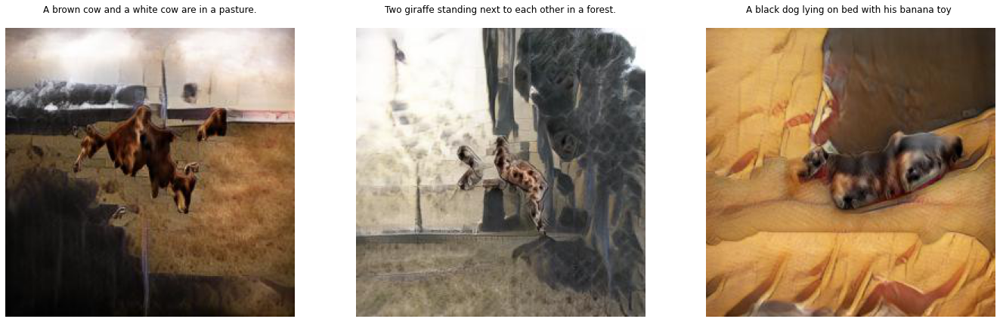

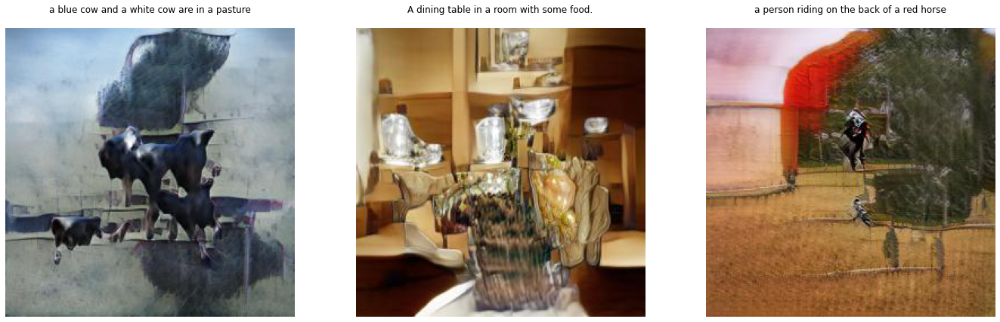

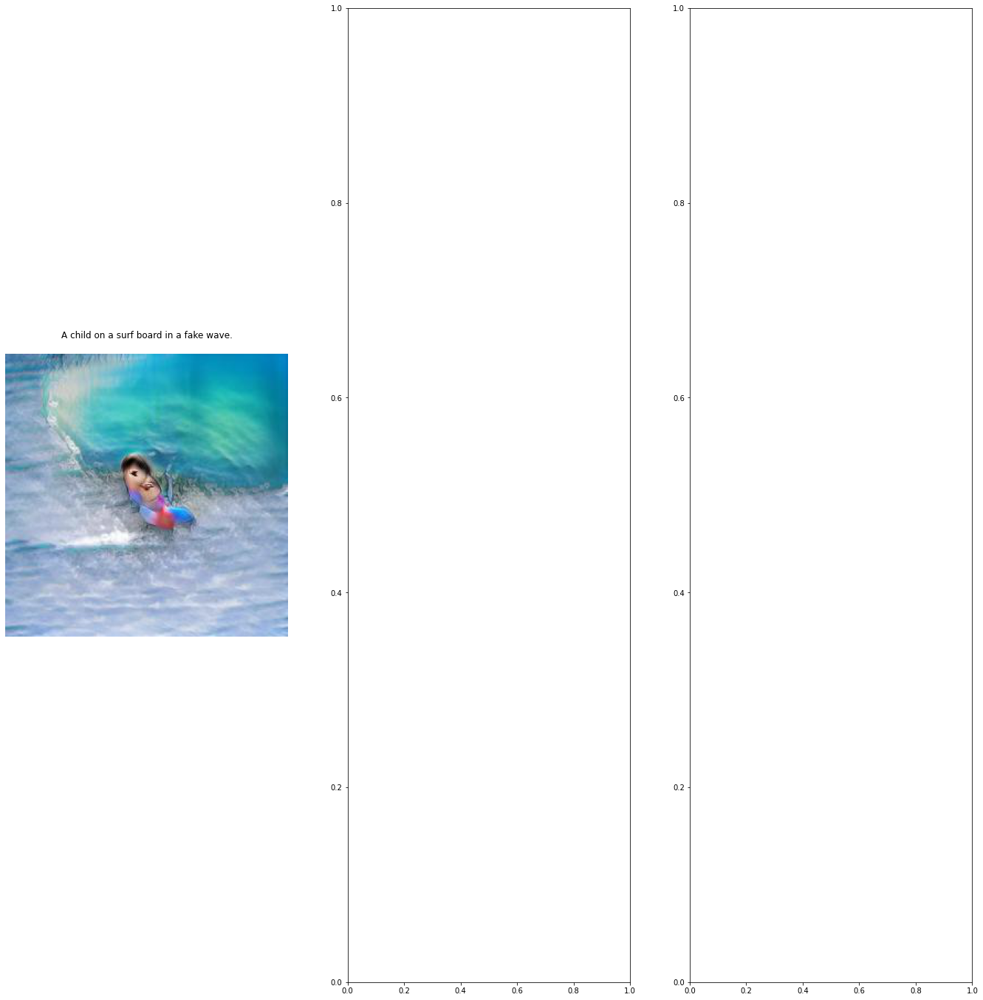

In [76]:
caps_loc = '/home/sazadi/projects/Obj-GAN/data/coco/text'
ims = glob.glob('/home/sazadi/projects/Obj-GAN/output_image_generation/coco_2020_07_07_01_19_07/Image/*.jpg')
im_names= [im.split('/')[-1].split('.jpg')[0] for im in ims]
num_embeddings = 5
sents = []
for im in im_names:
    sent_id = int(im.rsplit('_',1)[1]) % num_embeddings
    cap = '%s/%s.txt'%(caps_loc, im.rsplit('_',1)[0])
    with open(cap,'r') as f:
        f_names = f.readlines()
        sents.append(f_names[sent_id])

for i,im in enumerate(ims):
    if i%3==0:
        fig, axs = plt.subplots(1, 3, figsize=(20, 20))
        fig.tight_layout(pad=5.0)
    j = i%3
    axs[j].imshow(imread(im))
    axs[j].set_title(sents[i])#'%s\n %s'%(sents[i][0:35],sents[i][35:-1]))
    axs[j].set_axis_off()


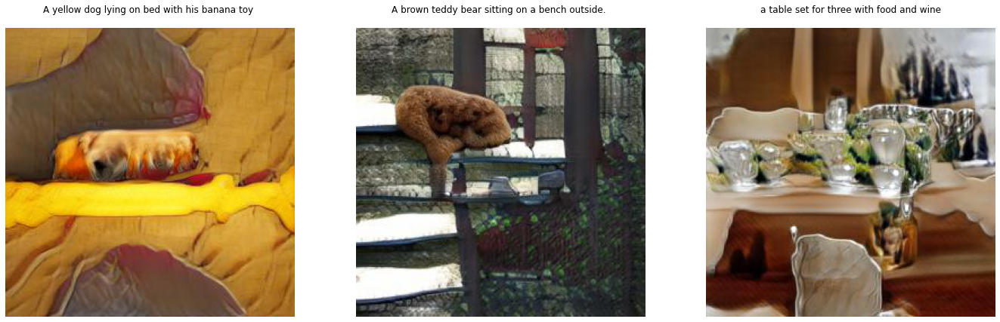

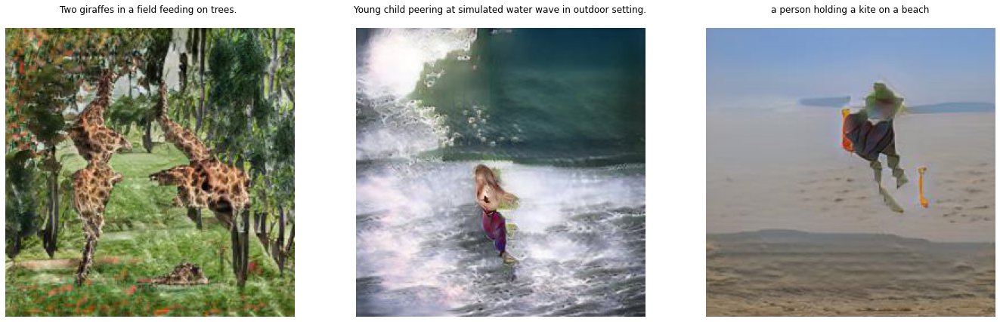

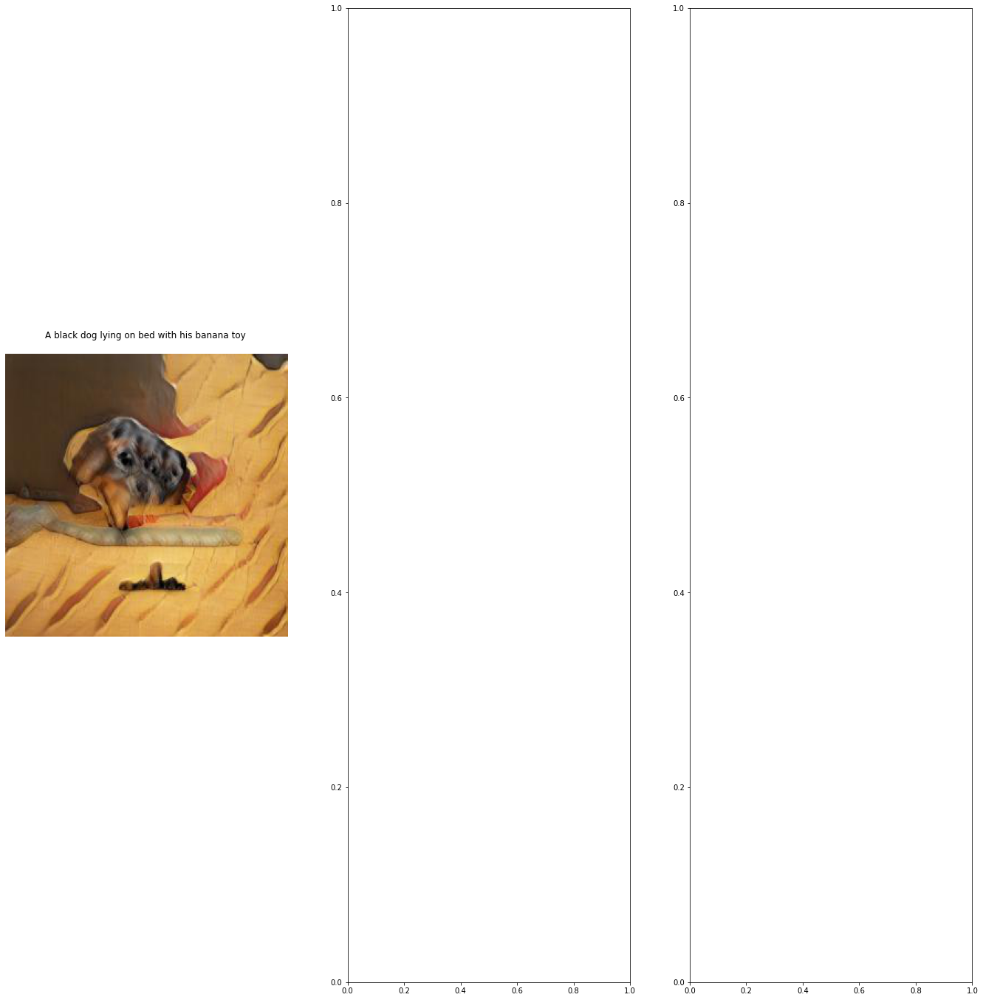

In [61]:
caps_loc = '/home/sazadi/projects/Obj-GAN/data/coco/text'
ims = glob.glob('/home/sazadi/projects/Obj-GAN/output_image_generation/coco_2020_07_05_22_54_24/Image/*.jpg')
im_names= [im.split('/')[-1].split('.jpg')[0] for im in ims]
num_embeddings = 5
sents = []
for im in im_names:
    sent_id = int(im.rsplit('_',1)[1]) % num_embeddings
    cap = '%s/%s.txt'%(caps_loc, im.rsplit('_',1)[0])
    with open(cap,'r') as f:
        f_names = f.readlines()
        sents.append(f_names[sent_id])

for i,im in enumerate(ims):
    if i%3==0:
        fig, axs = plt.subplots(1, 3, figsize=(20, 20))
        fig.tight_layout(pad=5.0)
    j = i%3
    axs[j].imshow(imread(im))
    axs[j].set_title(sents[i])#'%s\n %s'%(sents[i][0:35],sents[i][35:-1]))
    axs[j].set_axis_off()


(64, 64, 3)
(64, 64, 3)
(64, 64, 3)
(64, 64, 3)
(64, 64, 3)
(64, 64, 3)


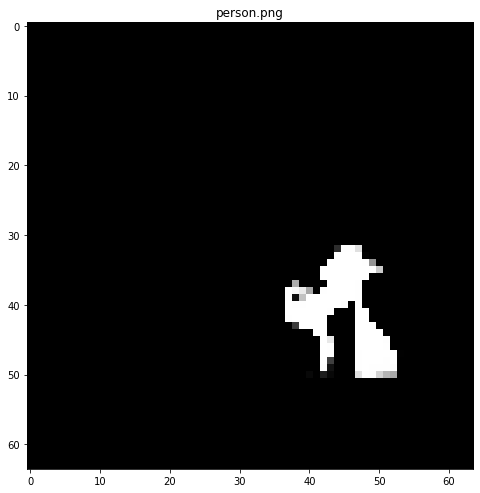

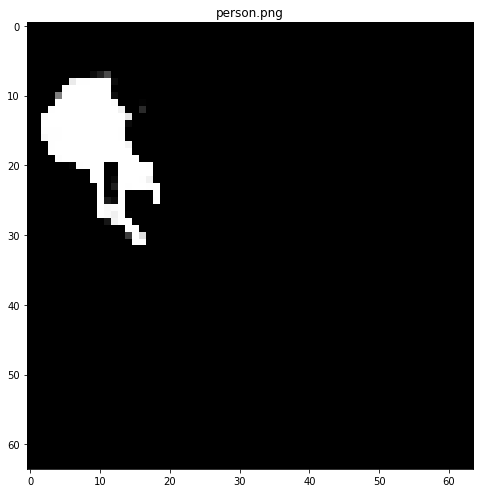

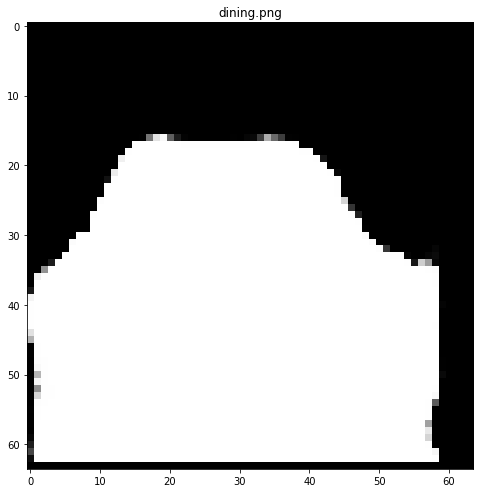

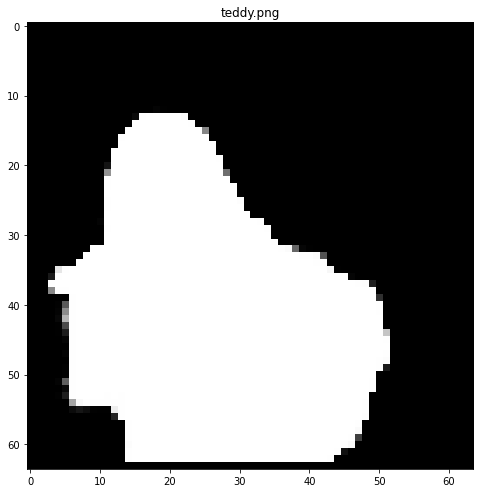

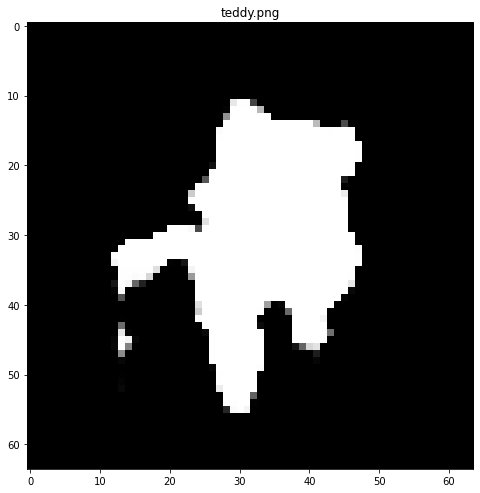

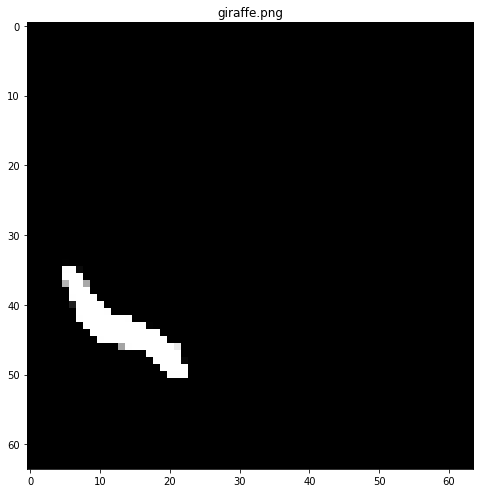

In [66]:
sps = glob.glob('../data/coco/pretrained/shape_gen/test_short/single/*')
for ff in sps:
    I = imread(ff)
    name = ff.split('_')[-1]
    figure()
    imshow(I)
    title(name)
    print(I.shape)

In [69]:
with open('../data/coco/test_short/filenames.pickle', 'rb') as fp:
    aa=pickle.load(fp)


In [70]:
print(aa)

['COCO_val2014_000000145009', 'COCO_val2014_000000338200', 'COCO_black_dog_banana', 'COCO_val2014_000000054679', 'COCO_val2014_000000297233', 'COCO_val2014_000000086843', 'COCO_yellow_dog_banana', 'COCO_red_horse', 'COCO_val2014_000000165643', 'COCO_val2014_000000573928', 'COCO_blue_cow', 'COCO_plane_tree']
